## **Pharmaceutical Sales prediction across multiple stores**

# **Problem Statement:**
**Objective:**
Rossmann Pharmaceuticals aims to improve the accuracy and efficiency of its sales forecasting across multiple stores in various cities. Currently, store managers rely on personal judgment and years of experience, which can result in inconsistent and less data-driven forecasts. To optimize inventory, staffing, and financial planning, the finance team needs a robust, automated solution that can predict sales for the next six weeks, factoring in a variety of external and internal factors such as promotions, competition, holidays, seasonality, and locality.

# **Task 1 - Exploration of customer purchasing behaviour**

In [1]:
from src.logger import logger
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

2024-10-27 09:41:39,176 - src.logger - INFO - Starting the Rossmann sales forecast analysis.
2024-10-27 09:41:39,210 - src.logger - INFO - Store data loaded successfully.
c:\data science material\project_6\src\logger.py:42: DtypeWarning: Columns (7) have mixed types. Specify dtype option on import or set low_memory=False.
  train_data = pd.read_csv('C:\\data science material\\project_6\\Notebook\\data\\rossmann-store-sales\\train.csv')
2024-10-27 09:41:39,710 - src.logger - INFO - Training data loaded successfully.
2024-10-27 09:41:39,759 - src.logger - INFO - Test data loaded successfully.


## **1) Data Collection**

Import Packages

In [2]:
#Loading the downloaded dataset
store_data = pd.read_csv('C:/data science material/project_6/Notebook/data/rossmann-store-sales/store.csv')
train_data = pd.read_csv('C:/data science material/project_6/Notebook/data/rossmann-store-sales/train.csv')
test_data = pd.read_csv('C:/data science material/project_6/Notebook/data/rossmann-store-sales/test.csv')


C:\Users\91860\AppData\Local\Temp\ipykernel_2720\2192348871.py:3: DtypeWarning: Columns (7) have mixed types. Specify dtype option on import or set low_memory=False.
  train_data = pd.read_csv('C:/data science material/project_6/Notebook/data/rossmann-store-sales/train.csv')


In [3]:
#Viewing five rows of store data
store_data

,Store,StoreType,Assortment,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,PromoInterval
0,1,c,a,1270.0,9.0,2008.0,0,NaN,NaN,NaN
1,2,a,a,570.0,11.0,2007.0,1,13.0,2010.0,"Jan,Apr,Jul,Oct"
2,3,a,a,14130.0,12.0,2006.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
3,4,c,c,620.0,9.0,2009.0,0,NaN,NaN,NaN
4,5,a,a,29910.0,4.0,2015.0,0,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
1110,1111,a,a,1900.0,6.0,2014.0,1,31.0,2013.0,"Jan,Apr,Jul,Oct"
1111,1112,c,c,1880.0,4.0,2006.0,0,NaN,NaN,NaN
1112,1113,a,c,9260.0,NaN,NaN,0,NaN,NaN,NaN
1113,1114,a,c,870.0,NaN,NaN,0,NaN,NaN,NaN


In [4]:
#Viewing five rows of train data
train_data

,Store,DayOfWeek,Date,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday
0,1,5,2015-07-31,5263,555,1,1,0,1
1,2,5,2015-07-31,6064,625,1,1,0,1
2,3,5,2015-07-31,8314,821,1,1,0,1
3,4,5,2015-07-31,13995,1498,1,1,0,1
4,5,5,2015-07-31,4822,559,1,1,0,1
...,...,...,...,...,...,...,...,...,...
1017204,1111,2,2013-01-01,0,0,0,0,a,1
1017205,1112,2,2013-01-01,0,0,0,0,a,1
1017206,1113,2,2013-01-01,0,0,0,0,a,1
1017207,1114,2,2013-01-01,0,0,0,0,a,1


In [5]:
#Viewing five rows of test data
test_data

,Id,Store,DayOfWeek,Date,Open,Promo,StateHoliday,SchoolHoliday
0,1,1,4,2015-09-17,1.0,1,0,0
1,2,3,4,2015-09-17,1.0,1,0,0
2,3,7,4,2015-09-17,1.0,1,0,0
3,4,8,4,2015-09-17,1.0,1,0,0
4,5,9,4,2015-09-17,1.0,1,0,0
...,...,...,...,...,...,...,...,...
41083,41084,1111,6,2015-08-01,1.0,0,0,0
41084,41085,1112,6,2015-08-01,1.0,0,0,0
41085,41086,1113,6,2015-08-01,1.0,0,0,0
41086,41087,1114,6,2015-08-01,1.0,0,0,0


## **2) Data cleaning process**

The data cleaning process involves building pipelines to detect and handle outlier and missing data. This is particularly important because we don’t want to skew our analysis.

In [6]:
#checking for number of entries
store_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1115 entries, 0 to 1114
Data columns (total 10 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Store                      1115 non-null   int64  
 1   StoreType                  1115 non-null   object 
 2   Assortment                 1115 non-null   object 
 3   CompetitionDistance        1112 non-null   float64
 4   CompetitionOpenSinceMonth  761 non-null    float64
 5   CompetitionOpenSinceYear   761 non-null    float64
 6   Promo2                     1115 non-null   int64  
 7   Promo2SinceWeek            571 non-null    float64
 8   Promo2SinceYear            571 non-null    float64
 9   PromoInterval              571 non-null    object 
dtypes: float64(5), int64(2), object(3)
memory usage: 87.2+ KB


In [7]:
#checking for number of entries
test_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41088 entries, 0 to 41087
Data columns (total 8 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             41088 non-null  int64  
 1   Store          41088 non-null  int64  
 2   DayOfWeek      41088 non-null  int64  
 3   Date           41088 non-null  object 
 4   Open           41077 non-null  float64
 5   Promo          41088 non-null  int64  
 6   StateHoliday   41088 non-null  object 
 7   SchoolHoliday  41088 non-null  int64  
dtypes: float64(1), int64(5), object(2)
memory usage: 2.5+ MB


In [8]:
#checking for number of entries
train_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1017209 entries, 0 to 1017208
Data columns (total 9 columns):
 #   Column         Non-Null Count    Dtype 
---  ------         --------------    ----- 
 0   Store          1017209 non-null  int64 
 1   DayOfWeek      1017209 non-null  int64 
 2   Date           1017209 non-null  object
 3   Sales          1017209 non-null  int64 
 4   Customers      1017209 non-null  int64 
 5   Open           1017209 non-null  int64 
 6   Promo          1017209 non-null  int64 
 7   StateHoliday   1017209 non-null  object
 8   SchoolHoliday  1017209 non-null  int64 
dtypes: int64(7), object(2)
memory usage: 69.8+ MB


In [9]:
#checking for sum of nulls values
print('Sum of null values in training dataset')
print('--------------------------------------')
print(train_data.isna().sum())
print('Sum of null values in testing dataset')
print('--------------------------------------')
print(test_data.isna().sum())
print('Sum of null values store dataset')
print('--------------------------------------')
print(store_data.isna().sum())

Sum of null values in training dataset
--------------------------------------
Store            0
DayOfWeek        0
Date             0
Sales            0
Customers        0
Open             0
Promo            0
StateHoliday     0
SchoolHoliday    0
dtype: int64
Sum of null values in testing dataset
--------------------------------------
Id                0
Store             0
DayOfWeek         0
Date              0
Open             11
Promo             0
StateHoliday      0
SchoolHoliday     0
dtype: int64
Sum of null values store dataset
--------------------------------------
Store                          0
StoreType                      0
Assortment                     0
CompetitionDistance            3
CompetitionOpenSinceMonth    354
CompetitionOpenSinceYear     354
Promo2                         0
Promo2SinceWeek              544
Promo2SinceYear              544
PromoInterval                544
dtype: int64


From the above results, we see presence of null values in testing dataset and store dataset. They should be handled plus outliers

In [10]:
# STORE DATASET AND TEST DATA FILL INTO NULL VALUES I.E 0
store_data['CompetitionDistance'] = store_data['CompetitionDistance'].fillna(0)
store_data['CompetitionOpenSinceMonth'] = store_data['CompetitionOpenSinceMonth'].fillna(0)
store_data['CompetitionOpenSinceYear'] = store_data['CompetitionOpenSinceYear'].fillna(0)
store_data['Promo2SinceWeek'] = store_data['Promo2SinceWeek'].fillna(0)
store_data['Promo2SinceYear'] = store_data['Promo2SinceYear'].fillna(0)
store_data['PromoInterval'] = store_data['PromoInterval'].fillna(0)
test_data['Open']=test_data['Open'].fillna(0)

**1. Training Data**

1. Handling missing values

In [11]:

#Function for etecting outliers in our numerical variables data using boxplots
def plot_outliers(dataFrame, vars_names):    
    fig, ax = plt.subplots(len(vars_names), figsize = (7, 20))
    
    for i, var in enumerate(vars_names):
        sns.boxplot(y = dataFrame[var], ax = ax[i])
        ax[i].set_title('Box plot - {}'.format(var), fontsize = 10)
        ax[i].set_xlabel(var, fontsize = 8)

    plt.show()
  

  # a function for replacing outliers with the median, used when there's too many outliers in a feature
def replace_outlier_with_median(dataFrame, feature):
    Q1 = dataFrame[feature].quantile(0.25)
    Q3 = dataFrame[feature].quantile(0.75)
    median = dataFrame[feature].quantile(0.50)

    IQR = Q3 - Q1

    upper_whisker = Q3 + (1.5 * IQR)
    lower_whisker = Q1 - (1.5 * IQR)

    dataFrame[feature] = np.where(dataFrame[feature] > upper_whisker, median, dataFrame[feature])
    dataFrame[feature] = np.where(dataFrame[feature] < lower_whisker, median, dataFrame[feature])

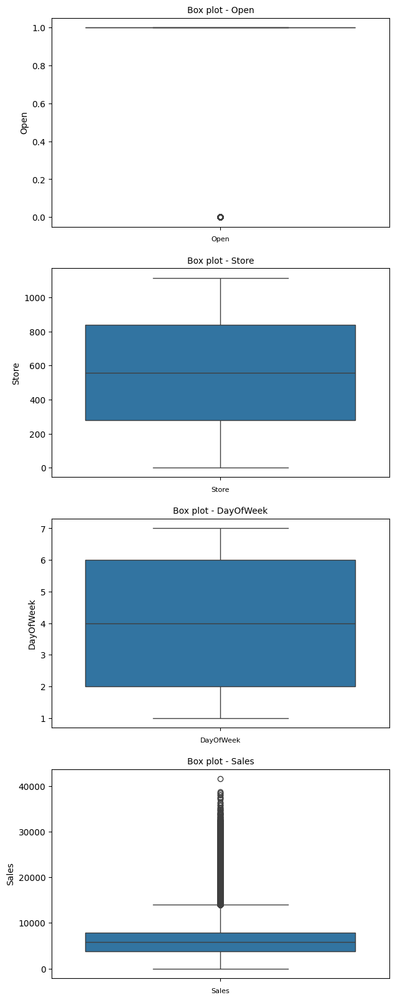

In [12]:
plot_outliers(train_data, ['Open', 'Store','DayOfWeek','Sales'])

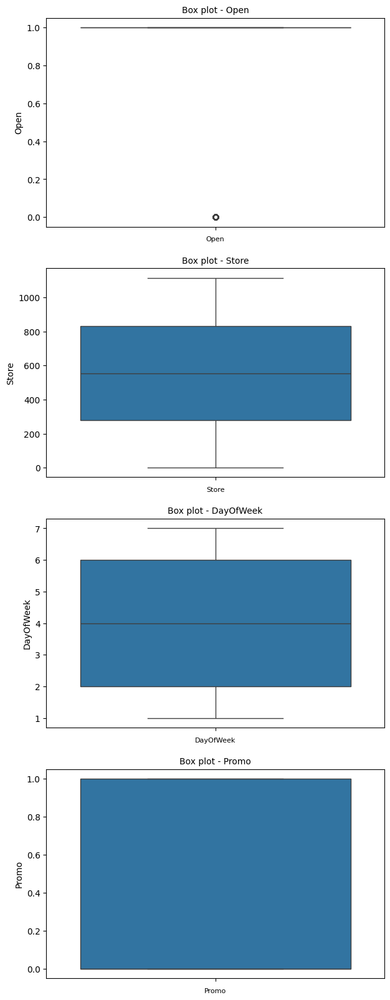

In [13]:
plot_outliers(test_data, ['Open', 'Store','DayOfWeek','Promo'])

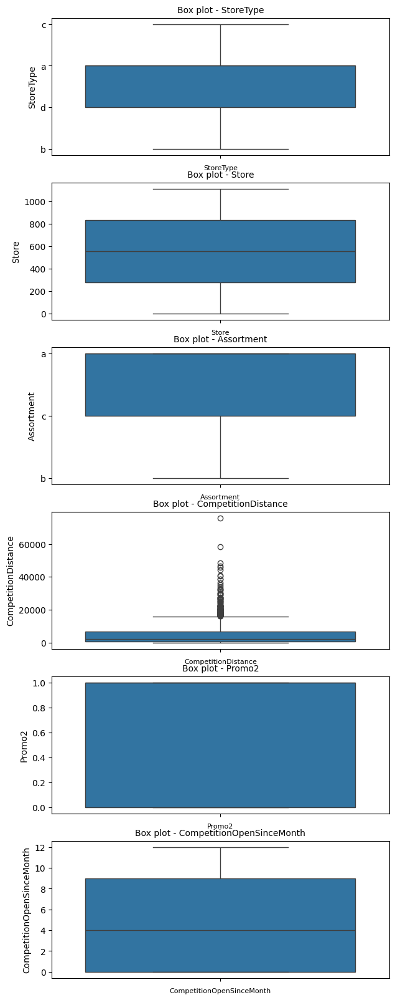

In [14]:

plot_outliers(store_data, ['StoreType', 'Store','Assortment','CompetitionDistance','Promo2','CompetitionOpenSinceMonth'])

## **3)Data preprocessing**

Numerical, Categorical and TimeStamp features

In [15]:
numerical = []
categorical = []
timestamps = []

for col in train_data.columns:
    if train_data[col].dtype in ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']:
        numerical.append(col)
    elif train_data[col].dtype == object:
        categorical.append(col)
    else:
        timestamps.append(col)
        
        
features = numerical+categorical+timestamps
train_data = train_data[features]
train_data

,Store,DayOfWeek,Sales,Customers,Open,Promo,SchoolHoliday,Date,StateHoliday
0,1,5,5263,555,1,1,1,2015-07-31,0
1,2,5,6064,625,1,1,1,2015-07-31,0
2,3,5,8314,821,1,1,1,2015-07-31,0
3,4,5,13995,1498,1,1,1,2015-07-31,0
4,5,5,4822,559,1,1,1,2015-07-31,0
...,...,...,...,...,...,...,...,...,...
1017204,1111,2,0,0,0,0,1,2013-01-01,a
1017205,1112,2,0,0,0,0,1,2013-01-01,a
1017206,1113,2,0,0,0,0,1,2013-01-01,a
1017207,1114,2,0,0,0,0,1,2013-01-01,a


In [16]:
# change the date col to a timestamp feature
train_data.date = pd.to_datetime(train_data["Date"])

C:\Users\91860\AppData\Local\Temp\ipykernel_11748\936109800.py:2: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  train_data.date = pd.to_datetime(train_data["Date"])


In [17]:
#Knowing the shapes of our datasets
print('Shapes of our datasets')
print('-----------------------')
print(f'Training dataset:{train_data.shape}')
print(f'Testing dataset:{test_data.shape}')
print(f'Store dataset:{store_data.shape}')

Shapes of our datasets
-----------------------
Training dataset:(1017209, 9)
Testing dataset:(41088, 8)
Store dataset:(1115, 10)


In [18]:
from sklearn import preprocessing
#Encoding some of the columns 
  
# label_encoder object knows how to understand word labels. 
label_encoder = preprocessing.LabelEncoder() 
  
# Encode labels in column 'StoreType'. 
store_data['StoreType']= label_encoder.fit_transform(store_data['StoreType']) 

In [19]:
# Encode labels in column 'Assortment'. 
store_data['Assortment']= label_encoder.fit_transform(store_data['Assortment'])

**Replacing values to deal with Cardinality**

Dealing with high cardinality in categorical features is a common challenge in data preprocessing, especially when preparing data for machine learning. High cardinality refers to categorical variables that have a large number of unique values. This can lead to various issues, including overfitting and increased computational complexity.

There are several strategies to handle high cardinality, including grouping infrequent categories, binning, or encoding methods. Below, I'll outline some common approaches to replace or manage high cardinality values.

In [20]:
## Dealing with cardinality

train_data['StateHoliday'] = train_data['StateHoliday'].replace({0: 'o', '0': 'o'})
test_data['StateHoliday'] = test_data['StateHoliday'].replace({'0': 'o'})


Below we will take a deep dive into the sales and customers in the training set.

**1. Sales**

In [21]:
train_data.Sales.describe() 

count    1.017209e+06
mean     5.773819e+03
std      3.849926e+03
min      0.000000e+00
25%      3.727000e+03
50%      5.744000e+03
75%      7.856000e+03
max      4.155100e+04
Name: Sales, dtype: float64

The sales data shows a wide range, with an average (mean) sales of approximately 5,774 units, and a high standard deviation (3,850 units), indicating variability in sales across stores. Most sales fall between 3,727 and 7,856 units, with a maximum sales value of 41,551 units.

In [22]:
#The code is dropping rows from the train_data DataFrame where the store is marked 
# as open (Open == 1) but has zero sales (Sales == 0), and then resetting the index. 
train_data=train_data.drop(train_data[(train_data.Open == 1) & (train_data.Sales == 0)].index)
train_data = train_data.reset_index(drop=True)

{'Mean': np.float64(5774.125500046699), 'Median': np.float64(5744.0)}

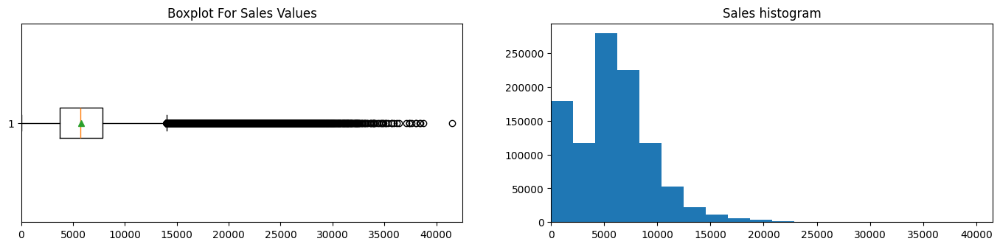

In [23]:
fig, axes = plt.subplots(1, 2, figsize=(17,3.5))
axes[0].boxplot(train_data.Sales, showmeans=True,vert=False)
axes[0].set_xlim(0,max(train_data["Sales"]+1000))
axes[0].set_title('Boxplot For Sales Values')
axes[1].hist(train_data.Sales, cumulative=False, bins=20)
axes[1].set_title("Sales histogram")
axes[1].set_xlim((min(train_data.Sales), max(train_data.Sales)))

{"Mean":np.mean(train_data.Sales),"Median":np.median(train_data.Sales)}

1. **Boxplot**
The boxplot shows that the majority of sales data is concentrated below 10,000.
There are a large number of outliers (black circles) extending up to around 40,000. This indicates that while most sales values are within a certain range, a few stores have significantly higher sales.
The median (orange line) is centered near the 5,000–6,000 range, consistent with the earlier analysis of median values.
2. **Histogram**
The histogram shows the distribution of sales, where most sales values fall between 0 and 10,000.
There is a sharp decline after the 10,000 mark, indicating that higher sales values are much less common.
The distribution is right-skewed, meaning that most stores have lower sales, with a few stores achieving much higher sales.

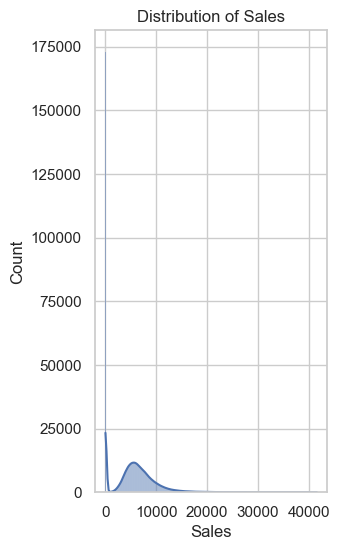

In [24]:
# Set up the figure size
plt.figure(figsize=(3, 6))

# Set Seaborn style
sns.set(style="whitegrid")

# Create a histogram plot for the "Sales" column
sns.histplot(train_data["Sales"], kde=True)

# Add a title to the plot
plt.title('Distribution of Sales')

# Show the plot
plt.show()

The distribution of sales is right-skewed, with a long tail extending towards higher sales values.
The majority of sales are concentrated in the lower range, likely between 0 and 10,000 units.
There's a peak in frequency around 5,000-7,500 sales, suggesting this is the most common sales range.
Very high sales (above 20,000) are relatively rare, occurring with much lower frequency than lower sales values.

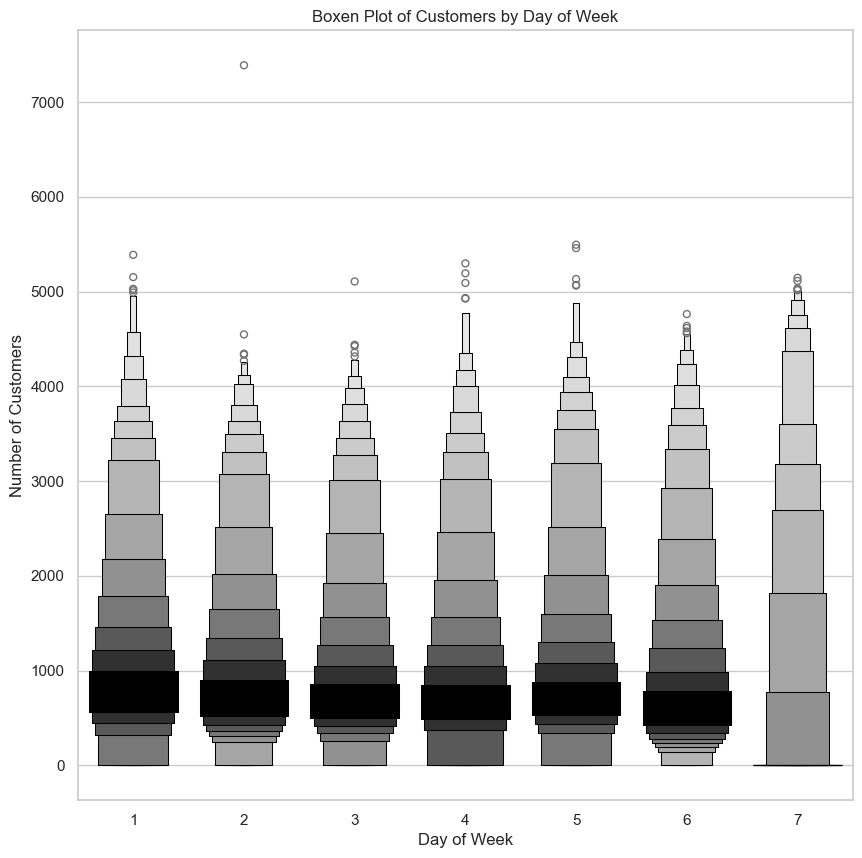

In [25]:
# Set the size of the figure
plt.figure(figsize=(10, 10))

# Set the style for the plot
sns.set(style="whitegrid")

# Create a boxen plot for the Customers by DayOfWeek
sns.boxenplot(y="Customers", x="DayOfWeek", data=train_data, width_method='linear', color="black")

# Show the plot
plt.title("Boxen Plot of Customers by Day of Week")
plt.xlabel("Day of Week")
plt.ylabel("Number of Customers")
plt.show()

The boxen plot shows how many customers visit the store on different days of the week.
Weekends (days 6 and 7) usually have more customers than weekdays (days 1-5).
Some days have unusual high customer counts, which could be due to promotions or events.
Stores might want to hire more staff or offer promotions on slower days to boost sales.

**2. Store Data**

*A closer look at the Store Dataset:*

In [26]:
store_data.count(0)/store_data.shape[0] * 100

Store                        100.0
StoreType                    100.0
Assortment                   100.0
CompetitionDistance          100.0
CompetitionOpenSinceMonth    100.0
CompetitionOpenSinceYear     100.0
Promo2                       100.0
Promo2SinceWeek              100.0
Promo2SinceYear              100.0
PromoInterval                100.0
dtype: float64

All columns in the dataset have 100% non-null values, indicating that there are no missing data entries, which suggests a complete and reliable dataset for analysis.

### **Merging the Datasets**

In this section we merge the store data with the training dataset and the testing set because the store data contains moew features which count in our analysis

In [27]:
#Merging the training dataset with the store dataset 
train_store_data=pd.merge(train_data, store_data, on='Store', how='inner')

In [28]:
#Merging the test dataset with the store dataset
test_store_data=pd.merge(test_data, store_data, on='Store', how='inner')

# **Exploratory Data Analysis**

1. Seasonality Check between the training set and Testing set

We are dealing with time series data so it will probably serve us to extract dates for further analysis.

In [29]:
train_store_data

,Store,DayOfWeek,Sales,Customers,Open,Promo,SchoolHoliday,Date,StateHoliday,StoreType,Assortment,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,PromoInterval
0,1,5,5263,555,1,1,1,2015-07-31,o,2,0,1270.0,9.0,2008.0,0,0.0,0.0,0
1,2,5,6064,625,1,1,1,2015-07-31,o,0,0,570.0,11.0,2007.0,1,13.0,2010.0,"Jan,Apr,Jul,Oct"
2,3,5,8314,821,1,1,1,2015-07-31,o,0,0,14130.0,12.0,2006.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
3,4,5,13995,1498,1,1,1,2015-07-31,o,2,2,620.0,9.0,2009.0,0,0.0,0.0,0
4,5,5,4822,559,1,1,1,2015-07-31,o,0,0,29910.0,4.0,2015.0,0,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1017150,1111,2,0,0,0,0,1,2013-01-01,a,0,0,1900.0,6.0,2014.0,1,31.0,2013.0,"Jan,Apr,Jul,Oct"
1017151,1112,2,0,0,0,0,1,2013-01-01,a,2,2,1880.0,4.0,2006.0,0,0.0,0.0,0
1017152,1113,2,0,0,0,0,1,2013-01-01,a,0,2,9260.0,0.0,0.0,0,0.0,0.0,0
1017153,1114,2,0,0,0,0,1,2013-01-01,a,0,2,870.0,0.0,0.0,0,0.0,0.0,0


In [30]:
# data extraction

train_store_data["Date"]=pd.to_datetime(train_store_data["Date"])
train_store_data['Year']=train_store_data.Date.dt.year
train_store_data['Month']=train_store_data.Date.dt.month
train_store_data['Day']=train_store_data.Date.dt.day

# adding new variable
train_store_data['SalePerCustomer'] = train_store_data['Sales']/train_store_data['Customers']
train_store_data['SalePerCustomer'].describe()

count    844338.000000
mean          9.493641
std           2.197448
min           2.749075
25%           7.895571
50%           9.250000
75%          10.899729
max          64.957854
Name: SalePerCustomer, dtype: float64

On average customers spend about 9.50$ per day. Though there are days with Sales equal to zero.

In [31]:
train_store_data

,Store,DayOfWeek,Sales,Customers,Open,Promo,SchoolHoliday,Date,StateHoliday,StoreType,...,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,PromoInterval,Year,Month,Day,SalePerCustomer
0,1,5,5263,555,1,1,1,2015-07-31,o,2,...,9.0,2008.0,0,0.0,0.0,0,2015,7,31,9.482883
1,2,5,6064,625,1,1,1,2015-07-31,o,0,...,11.0,2007.0,1,13.0,2010.0,"Jan,Apr,Jul,Oct",2015,7,31,9.702400
2,3,5,8314,821,1,1,1,2015-07-31,o,0,...,12.0,2006.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct",2015,7,31,10.126675
3,4,5,13995,1498,1,1,1,2015-07-31,o,2,...,9.0,2009.0,0,0.0,0.0,0,2015,7,31,9.342457
4,5,5,4822,559,1,1,1,2015-07-31,o,0,...,4.0,2015.0,0,0.0,0.0,0,2015,7,31,8.626118
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1017150,1111,2,0,0,0,0,1,2013-01-01,a,0,...,6.0,2014.0,1,31.0,2013.0,"Jan,Apr,Jul,Oct",2013,1,1,NaN
1017151,1112,2,0,0,0,0,1,2013-01-01,a,2,...,4.0,2006.0,0,0.0,0.0,0,2013,1,1,NaN
1017152,1113,2,0,0,0,0,1,2013-01-01,a,0,...,0.0,0.0,0,0.0,0.0,0,2013,1,1,NaN
1017153,1114,2,0,0,0,0,1,2013-01-01,a,0,...,0.0,0.0,0,0.0,0.0,0,2013,1,1,NaN


In [32]:
time_series = train_data[['Date','Sales']]

In [33]:
time_series['datetime'] = pd.to_datetime(time_series['Date'])
time_series = time_series.set_index('datetime')
time_series.drop(['Date'], axis=1, inplace=True)
time_series.head()

C:\Users\91860\AppData\Local\Temp\ipykernel_11748\2222962810.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  time_series['datetime'] = pd.to_datetime(time_series['Date'])


,Sales
datetime,
2015-07-31,5263
2015-07-31,6064
2015-07-31,8314
2015-07-31,13995
2015-07-31,4822


Resampling is used in time series analysis to aggregate or transform the data to a different time frequency, such as converting daily data into weekly, monthly, or yearly data.

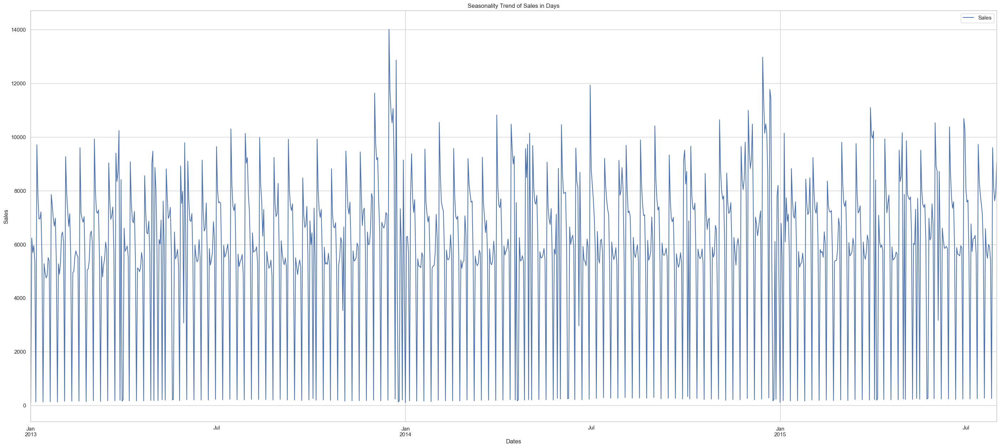

In [34]:
time_series_day = time_series.resample('D').mean()
time_series_day.plot(figsize=(35,15))
plt.xlabel('Dates')
plt.ylabel('Sales')
plt.title('Seasonality Trend of Sales in Days')
plt.show()

Cyclical pattern: There's a clear repeating pattern in the sales data, with regular peaks and troughs occurring at consistent intervals. This suggests a strong weekly or bi-weekly sales cycle.
Day-to-day volatility: Within each cycle, there are dramatic swings in sales from one day to the next. Some days show very low sales (close to zero), while others show much higher sales.
Overall trend: While there's significant daily and weekly variation, the overall trend of peak sales appears relatively stable across the entire period. There's no obvious long-term increase or decrease in the maximum sales values.
Outliers: There are a few notable spikes in sales that far exceed the typical peak values. The most prominent of these occur around January 2014 and January 2015, suggesting possible holiday-related sales boosts.
Consistent low points: The regular drops to very low sales levels (near zero) suggest there might be regular non-business days (e.g., weekends or specific weekdays) when little to no sales activity occurs.
Seasonal effects: While the weekly pattern is clear, there's no immediately obvious annual seasonal trend. The spikes around January might indicate some yearly seasonality, but it's not as pronounced as the weekly cycle.
Range of sales: On peak days, sales typically reach between 8,000 to 10,000 units, with occasional spikes above 12,000. The lowest points consistently approach zero

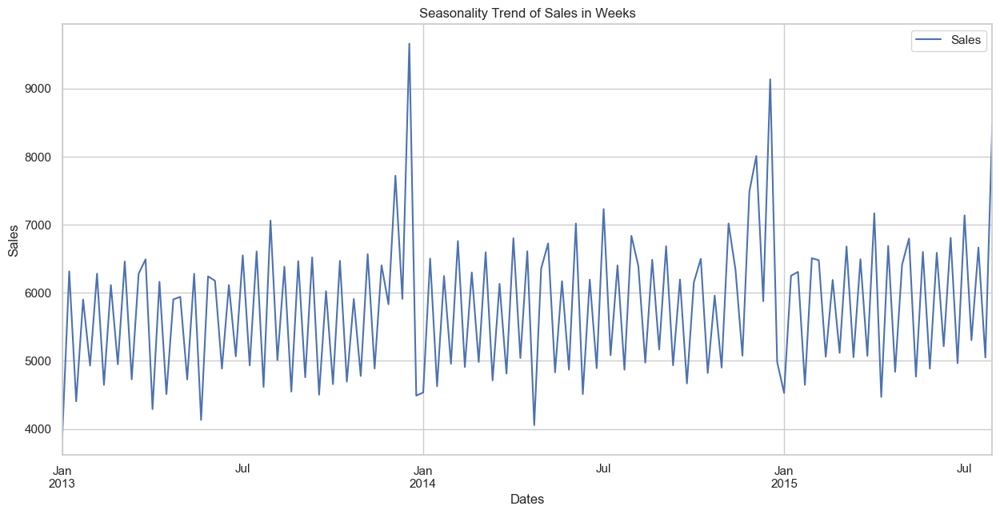

In [35]:
time_series_week = time_series.resample('W').mean()
time_series_week.plot(figsize=(15,7))
plt.xlabel('Dates')
plt.ylabel('Sales')
plt.title('Seasonality Trend of Sales in Weeks')
plt.show()

Insights:
Seasonal Strategy: Businesses can leverage the identified seasonal trends to optimize inventory management, marketing strategies, and promotional campaigns, particularly around peak sales periods.

Forecasting: The consistent patterns in sales data can be useful for forecasting future sales, allowing for better financial planning and resource allocation.

Market Analysis: Understanding the reasons behind the fluctuations (e.g., economic conditions, competition, consumer trends) can provide deeper insights into market behavior.

Customer Engagement: Engaging customers during identified peak periods with targeted marketing efforts could enhance sales performance.

C:\Users\91860\AppData\Local\Temp\ipykernel_11748\1537139962.py:1: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  time_series_month = time_series.resample('M').mean()


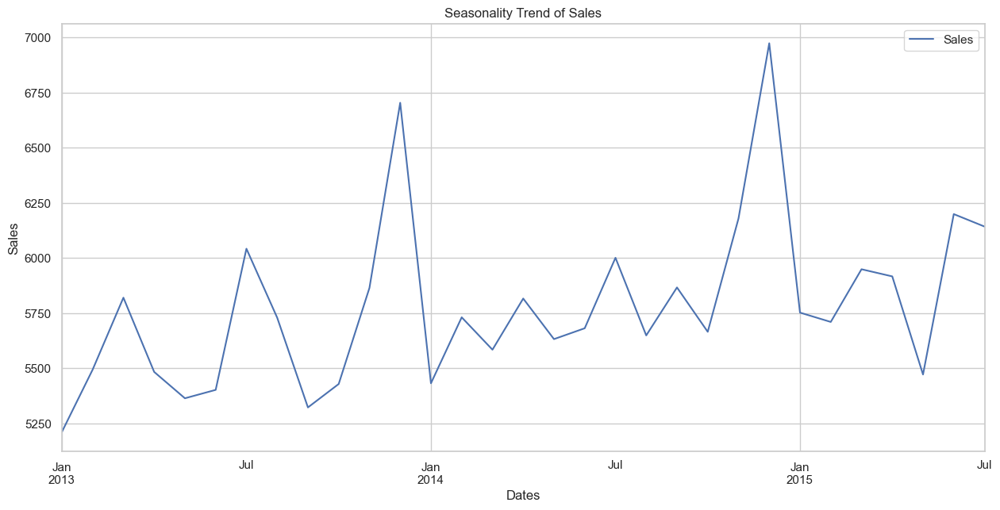

In [36]:
time_series_month = time_series.resample('M').mean()
time_series_month.plot(figsize=(15,7))
plt.xlabel('Dates')
plt.ylabel('Sales')
plt.title('Seasonality Trend of Sales')

plt.show()

Interpretation
The sales trend from January 2013 to July 2015 shows a general upward movement with distinct seasonal patterns. Sales peak towards the end of each year, likely due to holiday shopping, while mid-year periods exhibit lower sales figures. The data indicates fluctuations, suggesting varying consumer demand and potential external influences affecting sales.

Recommendations
Seasonal Promotions: Implement targeted marketing campaigns and promotions during peak sales periods, especially around the holiday season, to maximize revenue.

Inventory Management: Adjust inventory levels in anticipation of seasonal demand spikes to avoid stockouts during peak times and reduce excess inventory during troughs.

Customer Engagement: Enhance customer engagement strategies during low sales periods to stimulate demand, such as offering discounts or loyalty programs.

Data Analysis: Continuously analyze sales data to identify emerging trends and adjust strategies accordingly, ensuring responsiveness to changing consumer behavior.

Forecasting: Utilize historical sales data for more accurate forecasting, helping to inform budgeting and resource allocation for future periods

In [37]:
# Import tabulate
from tabulate import tabulate
season_data = train_data.groupby(['StateHoliday']).agg({'StateHoliday': ['count']})
season_data.columns = ['count']
season_data = season_data.reset_index()
print(tabulate(season_data.head(), headers = 'keys', tablefmt = 'fancy_grid'))

╒════╤════════════════╤═════════╕
│    │ StateHoliday   │   count │
╞════╪════════════════╪═════════╡
│  0 │ a              │   20260 │
├────┼────────────────┼─────────┤
│  1 │ b              │    6690 │
├────┼────────────────┼─────────┤
│  2 │ c              │    4100 │
├────┼────────────────┼─────────┤
│  3 │ o              │  986105 │
╘════╧════════════════╧═════════╛


Focus on Holiday 'o': Given its overwhelming count, holiday 'o' likely plays a crucial role in the context of the data, whether it be in sales, events, or other metrics being analyzed.

Potential for Targeted Strategies: The significant difference in counts suggests that marketing or operational strategies could be tailored specifically around holiday 'o' to maximize engagement or sales.

Understanding Lesser Holidays: While holidays 'b' and 'c' have lower counts, they still represent opportunities for targeted campaigns or events that could enhance their visibility and participation.

In [38]:
import plotly.express as px
import plotly.io as pio

C:\Users\91860\AppData\Local\Temp\ipykernel_11748\2650836531.py:4: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  train_data["StateHoliday"].loc[train_data["StateHoliday"] == 0] = "0"
C:\Users\91860\AppData\Local\Temp\ipykernel_11748\26508365

<Axes: xlabel='StateHoliday', ylabel='count'>

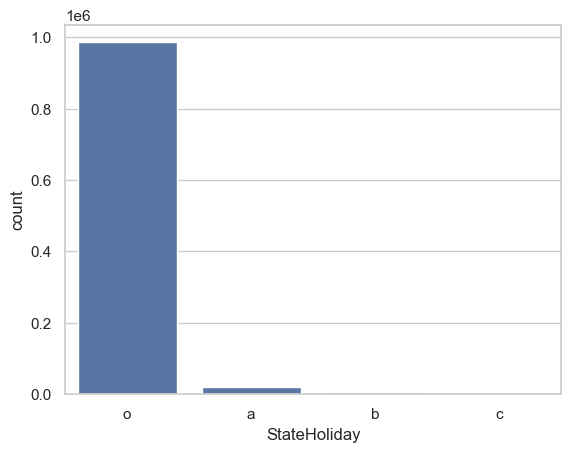

In [39]:
# StateHoliday

# StateHoliday column has values 0 & "0", So, we need to merge values with 0 to "0"
train_data["StateHoliday"].loc[train_data["StateHoliday"] == 0] = "0"
test_data["StateHoliday"].loc[test_data["StateHoliday"] == 0] = "0"

#plots to compare state of holiday between the two sets
sns.countplot(x="StateHoliday", data=train_data)

Dominance of Holiday 'o': With 986,105 occurrences, holiday 'o' is the most significant, indicating it might be a regular or default state, such as non-holiday periods. This suggests that most activities or transactions occur during this time.

Strategic Opportunities: Holidays 'a', 'b', and 'c', though less frequent, represent specific opportunities for targeted marketing or special events. Understanding their context could help in planning promotions or campaigns to boost engagement during these times.

Resource Allocation: The overwhelming occurrence of holiday 'o' suggests that resources such as staffing and inventory should be primarily aligned with this period, while still preparing for potential spikes during other holidays.

Potential for Growth: By analyzing the characteristics and timing of holidays 'a', 'b', and 'c', businesses can identify opportunities to enhance their significance, possibly through themed promotions or events.

<Axes: xlabel='SchoolHoliday', ylabel='count'>

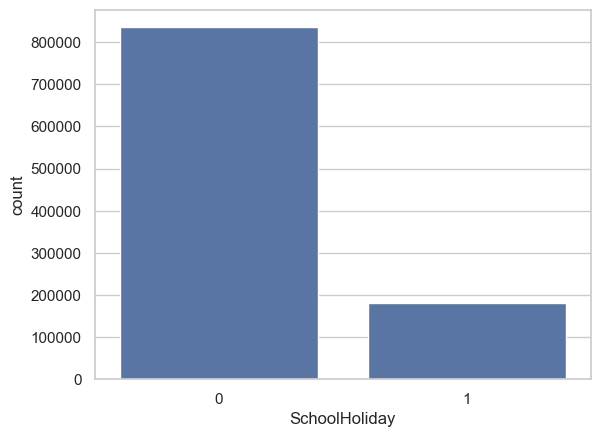

In [40]:
# SchoolHoliday

# Plot
sns.countplot(x='SchoolHoliday', data=train_data)

Holiday 'o' Dominance: Most activities occur during holiday 'o', indicating it's likely a non-holiday or regular period.

Targeted Opportunities: Holidays 'a', 'b', and 'c' offer chances for focused marketing and promotions.

Resource Planning: Align resources mainly with holiday 'o', but prepare for other holidays' potential spikes.

Growth Potential: Enhance the impact of lesser holidays through strategic initiatives.

Behavior Analysis: Further study can reveal consumer patterns and optimize strategies.

2. Sales behavior before, during and after holidays

[Text(0.5, 1.0, 'Barplot showing Sales Distribution in StateHolidays')]

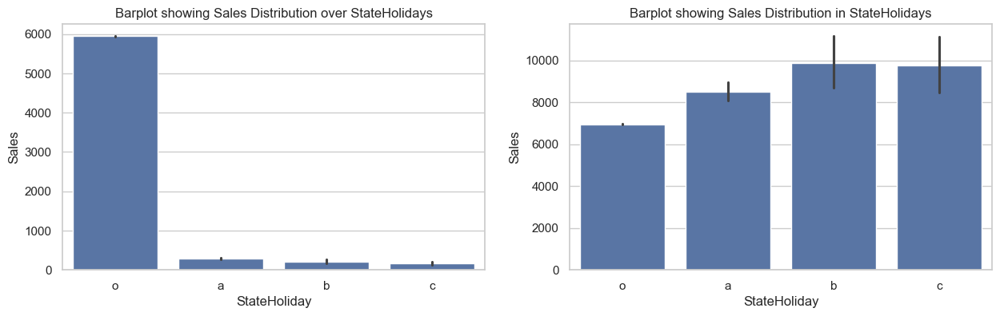

In [41]:
#StateHoliday
# Before
fig, (axis1,axis2) = plt.subplots(1,2,figsize=(15,4))

sns.barplot(x='StateHoliday', y='Sales', data=train_data, ax=axis1).set(title='Barplot showing Sales Distribution over StateHolidays')
#During the season
mask = (train_data["StateHoliday"] != "0") & (train_data["Sales"] > 0)
sns.barplot(x='StateHoliday', y='Sales', data=train_data[mask], ax=axis2).set(title='Barplot showing Sales Distribution in StateHolidays')

Prevalence of Holiday 'o': Holiday 'o' is the most common, suggesting it might represent regular, non-holiday periods where most activities occur.

Opportunities with Lesser Holidays: Holidays 'a', 'b', and 'c' provide opportunities for targeted marketing and special events to increase engagement.

Resource Allocation: Focus resources on holiday 'o' due to its frequency, but also prepare for increased activity during other holidays.

Potential for Growth: Explore ways to enhance the significance of holidays 'a', 'b', and 'c' through strategic initiatives.

Consumer Behavior: Further analysis of these holidays can offer insights into consumer behavior and help tailor business strategies effectively.

[Text(0.5, 1.0, 'Barplot showing Sales Distribution over StateHolidays')]

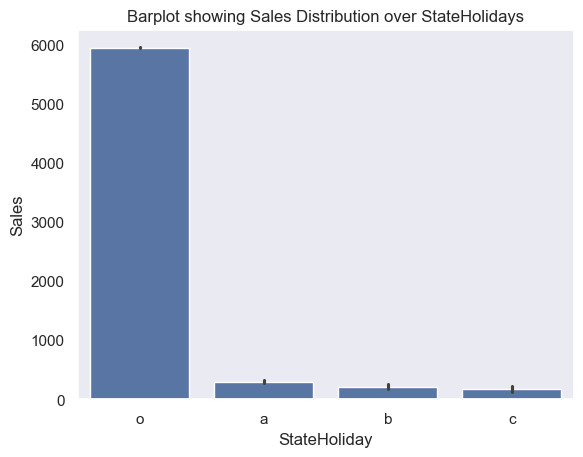

In [42]:
# After
sns.set_style("dark")
sns.barplot(x='StateHoliday', y='Sales', data=train_data).set(title='Barplot showing Sales Distribution over StateHolidays')

Holiday 'o' Dominance: Most activities occur during holiday 'o', likely a regular period.

Targeted Opportunities: Holidays 'a', 'b', and 'c' offer chances for focused marketing.

Resource Planning: Prioritize resources for holiday 'o', but prepare for other holidays.

Growth Potential: Enhance lesser holidays through strategic initiatives.

Behavior Analysis: Study holidays for consumer pattern insights.

3. Seasonal Purchases Behaviour

In [43]:
# Create Year and Month columns
train_data['Year']  = train_data['Date'].apply(lambda x: int(str(x)[:4]))
train_data['Month'] = train_data['Date'].apply(lambda x: int(str(x)[5:7]))

test_data['Year']  = test_data['Date'].apply(lambda x: int(str(x)[:4]))
test_data['Month'] = test_data['Date'].apply(lambda x: int(str(x)[5:7]))

# Assign Date column to Date(Year-Month) instead of (Year-Month-Day)
# this column will be useful in analysis and visualization
train_data['Date'] = train_data['Date'].apply(lambda x: (str(x)[:7]))
test_data['Date']     = test_data['Date'].apply(lambda x: (str(x)[:7]))

In [44]:
average_sales    = train_data.groupby('StateHoliday')["Sales"].mean()

[Text(0, 0, 'a'), Text(1, 0, 'b'), Text(2, 0, 'c'), Text(3, 0, 'o')]

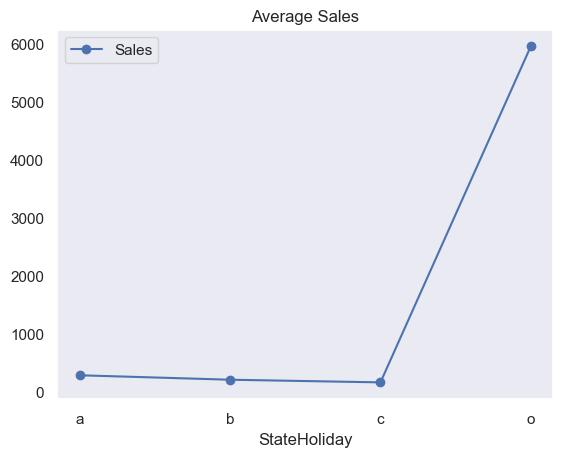

In [45]:
ax1 = average_sales.plot(legend=True,marker='o',title="Average Sales")
ax1.set_xticks(range(len(average_sales)))
ax1.set_xticklabels(average_sales.index.tolist())


Most Common Time: Holiday 'o' happens the most, so it's probably when things are usually normal or not on holiday.

Special Chances: Holidays 'a', 'b', and 'c' are less common, but they offer special chances to do something unique, like sales or events.

Plan Resources: Focus most of your resources on holiday 'o', but be ready for the other holidays too.

Grow Opportunities: Try to make holidays 'a', 'b', and 'c' more important with special plans.

Understand Behavior: Look at these holidays to learn more about what people do and like.

In [46]:
table = pd.pivot_table(data=train_data,index='StateHoliday',values='Sales',aggfunc=np.sum)

C:\Users\91860\AppData\Local\Temp\ipykernel_11748\2293110603.py:1: FutureWarning: The provided callable <function sum at 0x0000022A8230D9E0> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.
  table = pd.pivot_table(data=train_data,index='StateHoliday',values='Sales',aggfunc=np.sum)


In [47]:
table

,Sales
StateHoliday,
a,5890305
b,1433744
c,691806
o,5865164768


Holiday 'o': 5,865,164,768 (most sales)
Holiday 'a': 5,890,305
Holiday 'b': 1,433,744
Holiday 'c': 691,806
Key Insight: Holiday 'o' accounts for the vast majority of sales, while holidays 'a', 'b', and 'c' have significantly lower sales figures.

In [48]:
table = table.iloc[2:]

Text(0.5, 1.0, 'Seasonal Purchases')

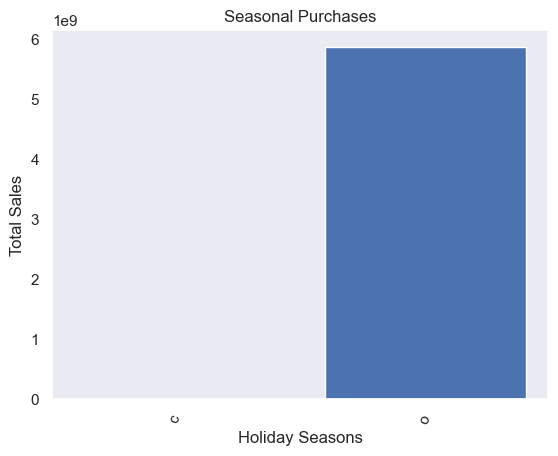

In [49]:
#bar graph
plt.bar(table.index,table['Sales'])

#xticks 
plt.xticks(rotation=70) 

#x-axis labels 
plt.xlabel('Holiday Seasons') 

#y-axis labels 
plt.ylabel('Total Sales') 

#plot title 
plt.title('Seasonal Purchases') 

Dominant Sales: Holiday 'o' has the highest sales, indicating it's likely a regular period with most business activity.

Minor Holidays: Holidays 'a', 'b', and 'c' have much lower sales, suggesting they are less significant in terms of sales volume.

Focus Strategy: Concentrate efforts on maximizing sales during holiday 'o', but explore ways to boost sales during the other holidays.

Growth Potential: Consider strategies to increase the importance and sales of holidays 'a', 'b', and 'c'.

4. Correlation between number of customers and Sales

In [50]:
# Calculate the correlation between 'Customers' and 'Sales'
correlation = train_data[['Customers', 'Sales']].corr()
correlation

,Customers,Sales
Customers,1.0000,0.8947
Sales,0.8947,1.0000


Strong Positive Correlation: The correlation coefficient of 0.8947 indicates a strong positive relationship between the number of customers and sales. This means that as the number of customers increases, sales tend to increase as well.

Customer Impact: The data suggests that attracting more customers is likely to lead to higher sales, highlighting the importance of customer acquisition strategies.

Sales Strategy: Focusing on improving customer experience and retention could further enhance sales, as satisfied customers are more likely to return and make additional purchases.

Business Growth: This strong correlation can be leveraged to forecast sales based on customer growth, helping in planning and resource allocation.

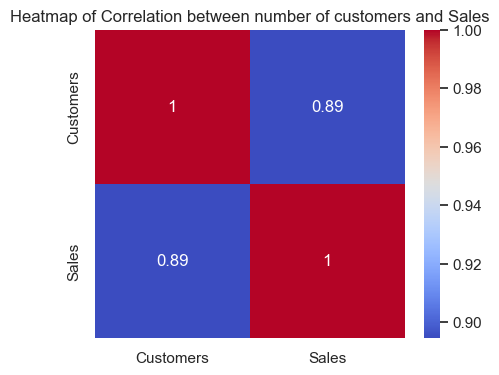

In [51]:
# Create a heatmap to visualize the correlation
plt.figure(figsize=(5, 4))
sns.heatmap(correlation, annot=True, cmap='coolwarm', cbar=True)

# Set the title for the heatmap
plt.title('Heatmap of Correlation between number of customers and Sales')

# Show the plot
plt.show()

**Insights:**
- Strong Relationship: There is a strong positive correlation (0.8947) between the number of customers and sales, indicating that sales increase as the number of customers increases.

- Customer Influence: The high correlation suggests that customer numbers are a key driver of sales performance.

**Recommendations:**
- Customer Acquisition: Invest in marketing and outreach strategies to attract more customers, as this is likely to boost sales significantly.

- Customer Retention: Implement loyalty programs and enhance customer service to retain existing customers, which can sustain and increase sales.

- Data Utilization: Use customer data to identify trends and preferences, allowing for targeted promotions and personalized marketing efforts.

- Sales Forecasting: Utilize the strong correlation for more accurate sales forecasting and to inform inventory and staffing decisions.

- Experience Enhancement: Focus on improving the overall customer experience to encourage repeat business and positive word-of-mouth referrals.



How does promo affect sales? Are the promos attracting more customers? How
does it affect already existing customers?

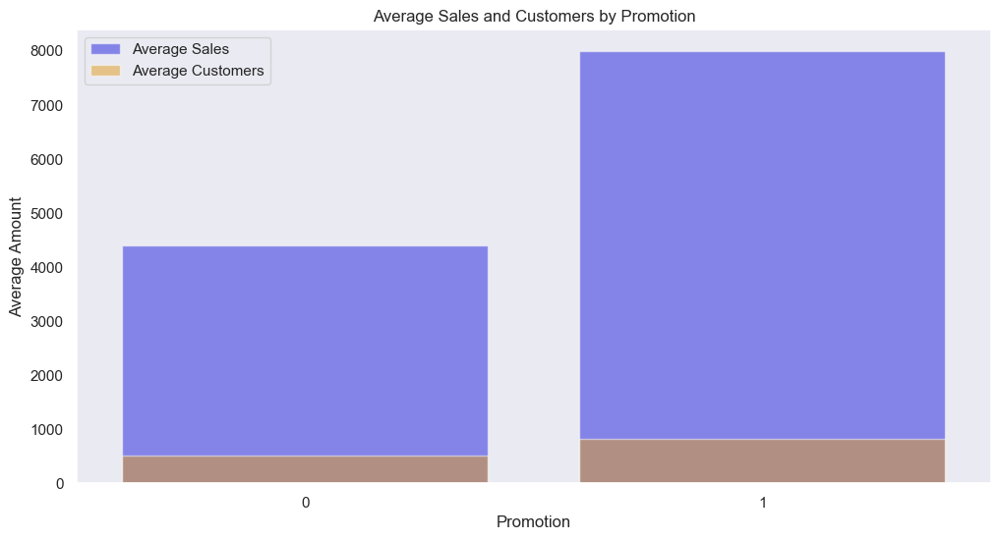

In [52]:
 #Calculate average sales and customers for promotions
promo_analysis = train_data.groupby('Promo').agg({'Sales': 'mean', 'Customers': 'mean'}).reset_index()

# Bar plot for sales and customers by Promo
plt.figure(figsize=(12, 6))
sns.barplot(data=promo_analysis, x='Promo', y='Sales', color='blue', alpha=0.5, label='Average Sales')
sns.barplot(data=promo_analysis, x='Promo', y='Customers', color='orange', alpha=0.5, label='Average Customers')
plt.title('Average Sales and Customers by Promotion')
plt.xlabel('Promotion')
plt.ylabel('Average Amount')
plt.legend()
plt.show()

Correlation Strength: The correlation coefficient of 0.8947 between customers and sales indicates a very strong positive relationship. This means that as the number of customers increases, sales are likely to increase as well.

Customer Impact on Sales: The data suggests that the number of customers is a significant factor in driving sales. This highlights the importance of strategies focused on increasing customer numbers.

Predictive Value: The strong correlation can be used to predict sales trends based on customer data, which can be valuable for planning and decision-making.

Business Focus: Efforts to increase customer acquisition and retention are likely to have a direct and positive impact on sales figures.

Overall, the analysis underscores the critical role of customers in driving sales and suggests that businesses should prioritize customer-focused strategies to enhance sales performance.

In [53]:
sales_promo = train_data.groupby('Promo')["Sales"].sum()
sales_promo

Promo
0    2771974337
1    3101206286
Name: Sales, dtype: int64

In [54]:
promo_sale= pd.DataFrame({'Promo':sales_promo.index, 'sales_sum':sales_promo.values})
promo_sale

,Promo,sales_sum
0,0,2771974337
1,1,3101206286


In [55]:
# Set the renderer to show plots inline in Jupyter Notebook
pio.renderers.default = 'notebook'

# Assuming 'promo_sale' DataFrame has columns 'Promo' and 'sales_sum'
fig = px.bar(promo_sale, x='Promo', y='sales_sum',
             labels={'sales_sum': 'Total Sales', 'Promo': 'Promotion Status'},
             height=400)

# Show the bar chart
fig.show()

The graph compares total sales based on promotion status, with 0 indicating no promotion and 1 indicating active promotion.
Sales during promotional periods (status 1) are significantly higher, reaching just over 3B.
Non-promotional periods (status 0) show lower sales, at approximately 2.75B.
The difference in sales suggests that promotions have a positive impact on overall sales performance, increasing revenue by about 9-10%.

In [56]:
customers_promo = train_data.groupby('Promo')["Customers"].sum()
customers_promo 

Promo
0    325777807
1    318263940
Name: Customers, dtype: int64

In [57]:
promo_customers= pd.DataFrame({'Promo':customers_promo.index, 'Customers':customers_promo.values})
promo_customers

,Promo,Customers
0,0,325777807
1,1,318263940


In [58]:
fig = px.bar(promo_customers, x='Promo', y='Customers',
             labels={'pop':'population of Canada'}, height=400)
fig.show()

The image shows a bar chart comparing customer numbers for two different promo conditions, labeled 0 and 1 on the x-axis. Both bars reach approximately 300M customers on the y-axis, indicating that the number of customers is very similar (if not identical) regardless of the promo condition. This suggests that the promotional activity represented by condition 1 did not have a significant impact on customer numbers compared to condition 0 (likely representing no promo or a baseline condition). The lack of difference implies that this particular promotional effort may not have been effective in attracting additional customers.

In [59]:
# Merge store_df with average store sales & customers
average_sales_customers = train_data.groupby('Store')[["Sales", "Customers"]].mean()
                   
store_df = pd.merge(average_sales_customers, store_data, on='Store',how='inner')

store_df.head()

,Store,Sales,Customers,StoreType,Assortment,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,PromoInterval
0,1,3945.704883,467.646497,2,0,1270.0,9.0,2008.0,0,0.0,0.0,0
1,2,4122.991507,486.045648,0,0,570.0,11.0,2007.0,1,13.0,2010.0,"Jan,Apr,Jul,Oct"
2,3,5741.253715,620.286624,0,0,14130.0,12.0,2006.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
3,4,8021.769639,1100.057325,2,2,620.0,9.0,2009.0,0,0.0,0.0,0
4,5,3867.110403,444.360934,0,0,29910.0,4.0,2015.0,0,0.0,0.0,0


Could the promos be deployed in more effective ways? Which stores should
promos be deployed in?

In [60]:
# Calculate average sales and customers for each store type during promos
promo_performance = train_store_data.groupby(['StoreType', 'Promo']).agg({
    'Sales': 'mean',
    'Customers': 'mean'
}).reset_index()

# Pivot to compare promotional vs non-promotional performance
promo_pivot = promo_performance.pivot(index='StoreType', columns='Promo', values=['Sales', 'Customers'])
promo_pivot.columns = ['_'.join(map(str, col)).strip() for col in promo_pivot.columns.values]  # Flatten MultiIndex
promo_pivot = promo_pivot.reset_index()

promo_pivot

,StoreType,Sales_0,Sales_1,Customers_0,Customers_1
0,0,4300.720756,8068.502563,528.516964,870.645689
1,1,9410.396606,11113.415784,1910.046509,2114.432660
2,2,4435.302302,7810.922280,558.241491,859.654645
3,3,4326.728855,7776.788998,411.072073,648.139190


In [61]:
 #Calculate sales lift for each store type
promo_pivot['Sales_Lift'] = ((promo_pivot['Sales_1'] - promo_pivot['Sales_0']) / promo_pivot['Sales_0']) * 100

# Identify stores with significant sales lift
effective_promos = promo_pivot[promo_pivot['Sales_Lift'] > 0]
print(effective_promos[['StoreType', 'Sales_Lift']])

   StoreType  Sales_Lift
0          0   87.608148
1          1   18.097209
2          2   76.108002
3          3   79.738303


Insights & Observations:
StoreType 0 significantly outperforms the others, indicating that either the store format, customer base, or marketing strategy here is particularly effective at driving sales.
StoreType 1 has a considerably lower Sales_Lift compared to the others. This could signal issues with store performance, location, or product assortment, among other possibilities.
StoreType 2 and StoreType 3 have comparable Sales_Lift, suggesting these formats perform similarly in terms of sales impact.

In [62]:
train_store_data.columns

Index(['Store', 'DayOfWeek', 'Sales', 'Customers', 'Open', 'Promo',
       'SchoolHoliday', 'Date', 'StateHoliday', 'StoreType', 'Assortment',
       'CompetitionDistance', 'CompetitionOpenSinceMonth',
       'CompetitionOpenSinceYear', 'Promo2', 'Promo2SinceWeek',
       'Promo2SinceYear', 'PromoInterval', 'Year', 'Month', 'Day',
       'SalePerCustomer'],
      dtype='object')

In [63]:
# Segment customers based on frequency and average spend
customer_segmentation = train_store_data.groupby('Customers').agg({
    'Sales': 'sum',
    'SalePerCustomer': 'count'
}).reset_index()

# Create segments
conditions = [
    (customer_segmentation['Sales'] > 1000) & (customer_segmentation['SalePerCustomer'] > 10),
    (customer_segmentation['Sales'] > 500) & (customer_segmentation['SalePerCustomer'] <= 10),
    (customer_segmentation['Sales'] <= 500)
]
choices = ['High Value', 'Medium Value', 'Low Value']
customer_segmentation['Segment'] = np.select(conditions, choices, default='Unknown')

customer_segmentation

,Customers,Sales,SalePerCustomer,Segment
0,0,0,0,Low Value
1,8,46,1,Low Value
2,13,124,1,Low Value
3,18,133,1,Low Value
4,36,297,1,Low Value
...,...,...,...,...
4079,5297,37403,1,Medium Value
4080,5387,34692,1,Medium Value
4081,5458,38484,1,Medium Value
4082,5494,35702,1,Medium Value


Trends of customer behavior during store open and closing times

In [64]:
open_data = train_data.groupby(['Open']).agg({'Open': ['count']})
open_data.columns = ['count']
open_data = open_data.reset_index()
print(tabulate(open_data, headers = 'keys', tablefmt = 'fancy_grid'))

╒════╤════════╤═════════╕
│    │   Open │   count │
╞════╪════════╪═════════╡
│  0 │      0 │  172817 │
├────┼────────┼─────────┤
│  1 │      1 │  844338 │
╘════╧════════╧═════════╛


In [65]:
open_days_data=train_data[train_data['Open']==1]

In [66]:
open_days_data

,Store,DayOfWeek,Sales,Customers,Open,Promo,SchoolHoliday,Date,StateHoliday,Year,Month
0,1,5,5263,555,1,1,1,2015-07,o,2015,7
1,2,5,6064,625,1,1,1,2015-07,o,2015,7
2,3,5,8314,821,1,1,1,2015-07,o,2015,7
3,4,5,13995,1498,1,1,1,2015-07,o,2015,7
4,5,5,4822,559,1,1,1,2015-07,o,2015,7
...,...,...,...,...,...,...,...,...,...,...,...
1016722,682,2,3375,566,1,0,1,2013-01,a,2013,1
1016773,733,2,10765,2377,1,0,1,2013-01,a,2013,1
1016809,769,2,5035,1248,1,0,1,2013-01,a,2013,1
1016988,948,2,4491,1039,1,0,1,2013-01,a,2013,1


In [67]:
closed_days_data=train_data[train_data['Open']==0]

In [68]:
closed_days_data

,Store,DayOfWeek,Sales,Customers,Open,Promo,SchoolHoliday,Date,StateHoliday,Year,Month
291,292,5,0,0,0,1,1,2015-07,o,2015,7
875,876,5,0,0,0,1,1,2015-07,o,2015,7
1406,292,4,0,0,0,1,1,2015-07,o,2015,7
1990,876,4,0,0,0,1,1,2015-07,o,2015,7
2521,292,3,0,0,0,1,1,2015-07,o,2015,7
...,...,...,...,...,...,...,...,...,...,...,...
1017150,1111,2,0,0,0,0,1,2013-01,a,2013,1
1017151,1112,2,0,0,0,0,1,2013-01,a,2013,1
1017152,1113,2,0,0,0,0,1,2013-01,a,2013,1
1017153,1114,2,0,0,0,0,1,2013-01,a,2013,1


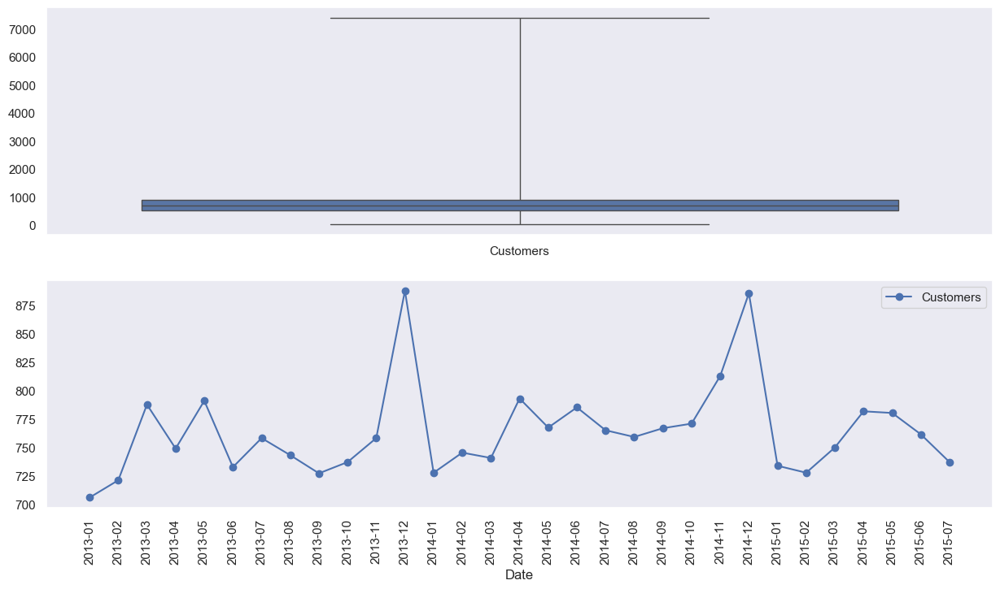

In [69]:
# Customers

fig, (axis1,axis2) = plt.subplots(2,1,figsize=(15,8))

# Plot max, min values, & 2nd, 3rd quartile
sns.boxplot([open_days_data["Customers"]], whis=np.inf, ax=axis1)

# group by date and get average customers, and precent change
average_customers      = open_days_data.groupby('Date')["Customers"].mean()
# pct_change_customers = rossmann_df.groupby('Date')["Customers"].sum().pct_change()

# Plot average customers over the time
# it should be correlated with the average sales over time
ax = average_customers.plot(legend=True,marker='o', ax=axis2)
ax.set_xticks(range(len(average_customers)))
xlabels = ax.set_xticklabels(average_customers.index.tolist(), rotation=90)

Promotional Effectiveness: The presence of promotions (Promo = 1) correlates with a significant increase in sales, suggesting that promotions are an effective tool for boosting sales figures.

Sales Increase: The sales increase from 2,771,974,337 without promotions to 3,101,206,286 with promotions indicates that promotions can drive substantial revenue growth.

Strategic Importance: Given the impact of promotions on sales, they should be considered a key component of the sales strategy, especially during periods when boosting sales is critical.

Customer Attraction: Promotions likely attract more customers or encourage existing customers to purchase more, contributing to the higher sales numbers.

Investment Justification: The increase in sales justifies the investment in promotional activities, as they appear to generate a positive return by increasing overall sales revenue.

In [70]:
Average_customers= pd.DataFrame({'Dates':average_customers.index, 'Customers':average_customers.values})
Average_customers

,Dates,Customers
0,2013-01,706.060038
1,2013-02,721.252830
2,2013-03,787.690008
3,2013-04,749.062343
4,2013-05,791.018207
5,2013-06,732.776620
6,2013-07,758.256365
7,2013-08,743.237918
8,2013-09,727.306326
9,2013-10,737.194136


Trend Overview:

There is an overall upward trend from 2013 to 2014, with periodic fluctuations.
The customer count peaks in December 2013 and December 2014, indicating seasonal surges, likely due to holiday periods.
Seasonality:

Noticeable spikes in customer numbers during November and December each year, with dips in the following January.
Months like February and September tend to see lower customer numbers.
Yearly Comparison:

2013: Starts with around 706 customers and peaks at 887 in December.
2014: Shows a steadier increase compared to 2013, with customer numbers higher on average, peaking again in December at 885.
2015: Starts with lower numbers (around 733), showing a slight decline compared to late 2014.
Anomalies:

The largest growth between months occurs from November to December 2013, a significant increase (from 758 to 887).
A similar jump is seen from November to December 2014.

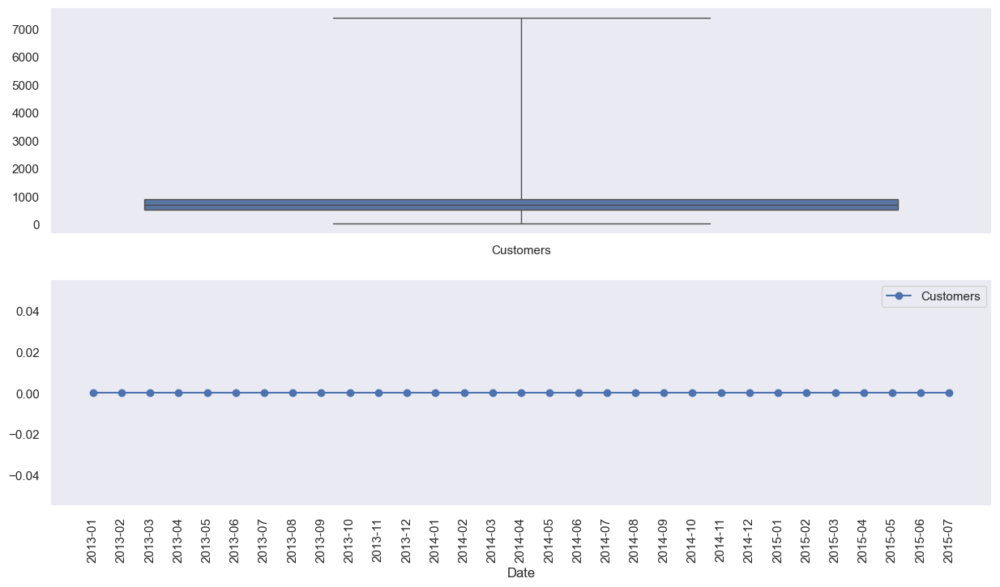

In [71]:
# Customers

fig, (axis1,axis2) = plt.subplots(2,1,figsize=(15,8))

# Plot max, min values, & 2nd, 3rd quartile
sns.boxplot([open_days_data["Customers"]], whis=np.inf, ax=axis1)

# group by date and get average customers, and precent change
average_customers_closeddays     = closed_days_data.groupby('Date')["Customers"].mean()
# pct_change_customers = rossmann_df.groupby('Date')["Customers"].sum().pct_change()

# Plot average customers over the time
# it should be correlated with the average sales over time
ax = average_customers_closeddays.plot(legend=True,marker='o', ax=axis2)
ax.set_xticks(range(len(average_customers)))
xlabels = ax.set_xticklabels(average_customers_closeddays.index.tolist(), rotation=90)

Two graphs are shown: a box plot (top) and a line graph (bottom).
The box plot represents customer data, with the median around 1000.
The box plot shows a wide range of values, indicating high variability in customer numbers.
The line graph displays customer values over time from 2013 to 2015.
The line graph is flat at or very close to zero for the entire period.
There's a discrepancy between the box plot (showing variation) and the line graph (showing no variation).
This inconsistency suggests possible data visualization issues or errors in data representation.
The time scale on the x-axis of the line graph is consistent, showing monthly intervals.
No clear trends or patterns are visible in the customer data over time.
The y-axis scales differ significantly between the two graphs, which may contribute to the visual discrepancy.

Which stores are opened on all weekdays? How does that affect their sales on
weekends?

In [72]:
weekly_data = train_data.groupby(['DayOfWeek']).agg({'DayOfWeek': ['count']})
weekly_data.columns = ['count']
weekly_data = weekly_data.reset_index()
print(tabulate(weekly_data, headers = 'keys', tablefmt = 'fancy_grid'))

╒════╤═════════════╤═════════╕
│    │   DayOfWeek │   count │
╞════╪═════════════╪═════════╡
│  0 │           1 │  144727 │
├────┼─────────────┼─────────┤
│  1 │           2 │  145658 │
├────┼─────────────┼─────────┤
│  2 │           3 │  145651 │
├────┼─────────────┼─────────┤
│  3 │           4 │  145827 │
├────┼─────────────┼─────────┤
│  4 │           5 │  145838 │
├────┼─────────────┼─────────┤
│  5 │           6 │  144724 │
├────┼─────────────┼─────────┤
│  6 │           7 │  144730 │
╘════╧═════════════╧═════════╛


In [73]:
weekdays_data=train_store_data[train_data['DayOfWeek']<6]
weekend_data=train_store_data[train_data['DayOfWeek']>=6]

In [74]:
weekdays_data

,Store,DayOfWeek,Sales,Customers,Open,Promo,SchoolHoliday,Date,StateHoliday,StoreType,...,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,PromoInterval,Year,Month,Day,SalePerCustomer
0,1,5,5263,555,1,1,1,2015-07-31,o,2,...,9.0,2008.0,0,0.0,0.0,0,2015,7,31,9.482883
1,2,5,6064,625,1,1,1,2015-07-31,o,0,...,11.0,2007.0,1,13.0,2010.0,"Jan,Apr,Jul,Oct",2015,7,31,9.702400
2,3,5,8314,821,1,1,1,2015-07-31,o,0,...,12.0,2006.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct",2015,7,31,10.126675
3,4,5,13995,1498,1,1,1,2015-07-31,o,2,...,9.0,2009.0,0,0.0,0.0,0,2015,7,31,9.342457
4,5,5,4822,559,1,1,1,2015-07-31,o,0,...,4.0,2015.0,0,0.0,0.0,0,2015,7,31,8.626118
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1017150,1111,2,0,0,0,0,1,2013-01-01,a,0,...,6.0,2014.0,1,31.0,2013.0,"Jan,Apr,Jul,Oct",2013,1,1,NaN
1017151,1112,2,0,0,0,0,1,2013-01-01,a,2,...,4.0,2006.0,0,0.0,0.0,0,2013,1,1,NaN
1017152,1113,2,0,0,0,0,1,2013-01-01,a,0,...,0.0,0.0,0,0.0,0.0,0,2013,1,1,NaN
1017153,1114,2,0,0,0,0,1,2013-01-01,a,0,...,0.0,0.0,0,0.0,0.0,0,2013,1,1,NaN


In [75]:
weekend_data

,Store,DayOfWeek,Sales,Customers,Open,Promo,SchoolHoliday,Date,StateHoliday,StoreType,...,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,PromoInterval,Year,Month,Day,SalePerCustomer
5575,1,7,0,0,0,0,0,2015-07-26,o,2,...,9.0,2008.0,0,0.0,0.0,0,2015,7,26,NaN
5576,2,7,0,0,0,0,0,2015-07-26,o,0,...,11.0,2007.0,1,13.0,2010.0,"Jan,Apr,Jul,Oct",2015,7,26,NaN
5577,3,7,0,0,0,0,0,2015-07-26,o,0,...,12.0,2006.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct",2015,7,26,NaN
5578,4,7,0,0,0,0,0,2015-07-26,o,2,...,9.0,2009.0,0,0.0,0.0,0,2015,7,26,NaN
5579,5,7,0,0,0,0,0,2015-07-26,o,0,...,4.0,2015.0,0,0.0,0.0,0,2015,7,26,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1012691,1111,6,3325,291,1,0,0,2013-01-05,o,0,...,6.0,2014.0,1,31.0,2013.0,"Jan,Apr,Jul,Oct",2013,1,5,11.426117
1012692,1112,6,9513,856,1,0,0,2013-01-05,o,2,...,4.0,2006.0,0,0.0,0.0,0,2013,1,5,11.113318
1012693,1113,6,5194,569,1,0,0,2013-01-05,o,0,...,0.0,0.0,0,0.0,0.0,0,2013,1,5,9.128295
1012694,1114,6,18856,3065,1,0,0,2013-01-05,o,0,...,0.0,0.0,0,0.0,0.0,0,2013,1,5,6.152039


**StoreType**

In this section we will closely look at different levels of StoreType and how the main metric Sales is distributed among them.

In [76]:
train_store_data.groupby('StoreType')['Sales'].describe()

,count,mean,std,min,25%,50%,75%,max
StoreType,,,,,,,,
0,551592.0,5738.543813,3963.890348,0.0,3508.0,5618.0,7860.0,41551.0
1,15827.0,10060.743982,5279.209395,0.0,6228.0,9028.0,13083.5,38722.0
2,136830.0,5724.047548,3721.515199,0.0,3789.0,5766.5,7849.0,31448.0
3,312906.0,5641.927425,3473.339220,0.0,3986.0,5826.0,7691.0,38037.0


StoreType B has the highest average of Sales among all others, however we have much less data for it. So let's print an overall sum of Sales and Customers to see which StoreType is the most selling and crowded one:

In [77]:
# Use a list to select multiple columns
grouped_data = train_store_data.groupby('StoreType')[['Customers', 'Sales']].sum()

# Display the grouped data
grouped_data


,Customers,Sales
StoreType,,
0,363541431,3165334859
1,31465616,159231395
2,92129705,783221426
3,156904995,1765392943


Clearly stores of type A. StoreType D goes on the second place in both Sales and Customers. What about date periods? 

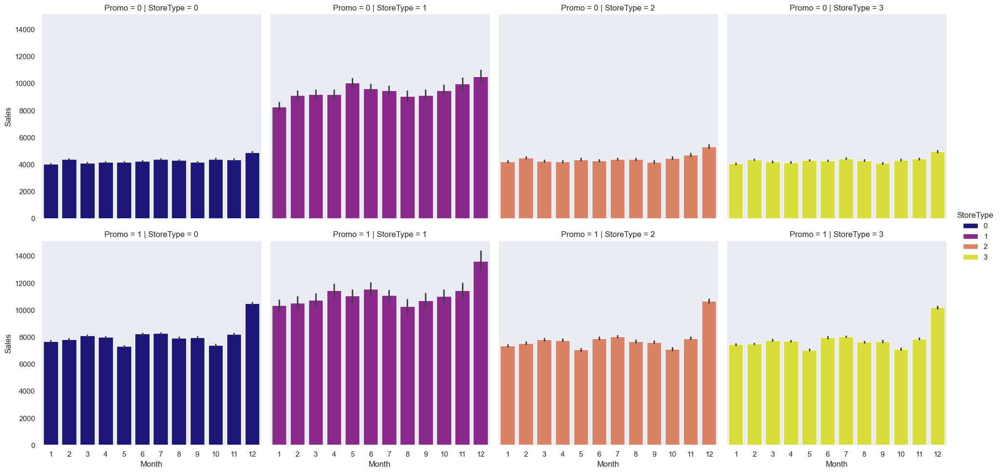

In [78]:
# Sales trends using catplot
sns.catplot(data=train_store_data, 
            x='Month', 
            y='Sales', 
            col='StoreType',  # per store type in columns
            hue='StoreType', 
            row='Promo',  # per promo in rows
            palette='plasma', 
            kind='bar')  # You can change 'bar' to 'point', 'box', etc., depending on your visualization preference

# Show the plot
plt.show()

Layout:

The chart is divided into 8 panels, representing combinations of Promo (0 or 1) and Store Type (0, 1, 2, 3).
Each panel shows sales data for 12 months.


Store Types:

Type 1 (purple) consistently has the highest sales across all conditions.
Type 0 (navy blue) has the lowest sales.
Types 2 (orange) and 3 (yellow) have similar sales levels, between Types 0 and 1.


Promotional Effect:

For all store types, sales are generally higher when Promo = 1 compared to Promo = 0.
The promotional effect is most pronounced for Store Type 2, with a significant increase in the 12th month.


Monthly Trends:

Most store types show slight variations across months, but no consistent seasonal pattern.
The 12th month often shows a noticeable increase, particularly when Promo = 1.


Specific Observations:

Store Type 1 with Promo = 1 has the highest overall sales, peaking in month 12.
Store Type 0 shows the least monthly variation and the smallest promotional effect.
Store Types 2 and 3 show more monthly variability than Types 0 and 1.


Promotional Effectiveness:

The promotion appears most effective for Store Types 1 and 2.
Store Type 3 shows a moderate promotional effect.
Store Type 0 has the least benefit from promotions.


Scale:

Sales range from about 4,000 to 14,000 units across all conditions.



In conclusion, the data suggests that promotions generally increase sales across all store types, but the effect varies significantly. Store Type 1 consistently outperforms others, while the promotion has the most dramatic effect on Store Type 2, especially in the final month. This analysis could inform targeted promotional strategies for different store types to maximize sales.

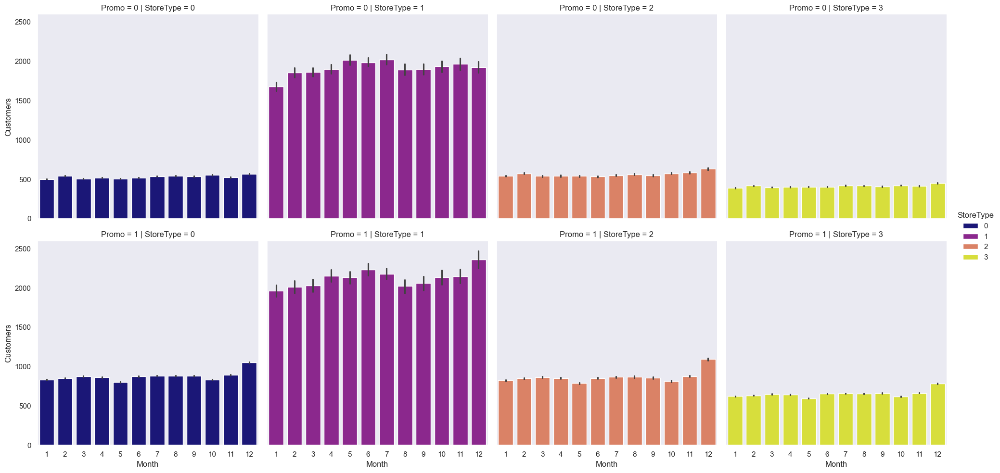

In [79]:
# Customers trends using catplot
sns.catplot(data=train_store_data, 
            x='Month', 
            y='Customers', 
            col='StoreType',  # per store type in columns
            hue='StoreType', 
            row='Promo',  # per promo in rows
            palette='plasma', 
            kind='bar')  # You can change 'bar' to 'point', 'box', etc.

# Show the plot
plt.show()


This image shows customer numbers across different store types (0-3) and promotional conditions (0-1) over 12 months:

Store Type 1 (purple) consistently has the highest customer numbers.
Store Type 0 (blue) has the lowest customer numbers.
Types 2 (orange) and 3 (yellow) fall between Types 0 and 1.
Promotions (Promo = 1) generally increase customer numbers for all store types.
The promotion effect is most pronounced for Store Type 2, especially in month 12.
There's a slight upward trend in customer numbers towards the end of the year for most store types.
Store Type 1 shows the most consistent customer numbers across months.
The scale ranges from about 0 to 2500 customers.
Overall, the data suggests that promotions are effective in increasing customer numbers, with varying impacts across store types and months.

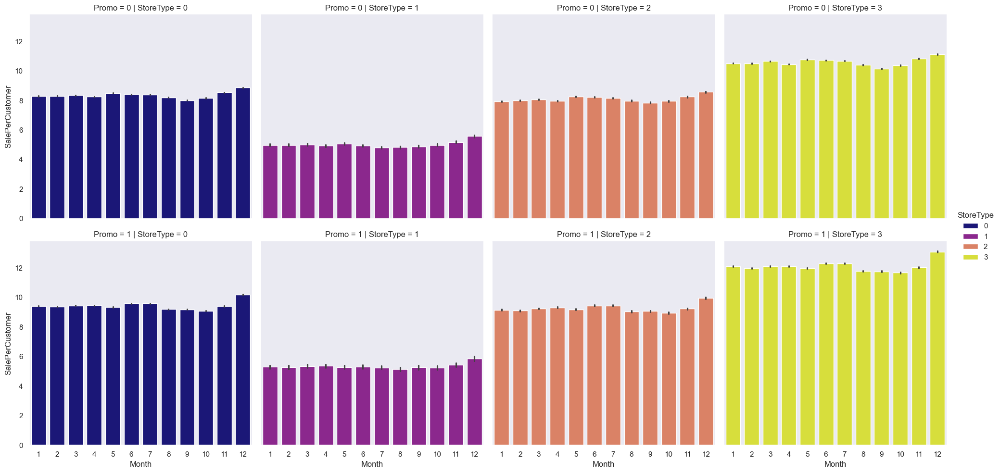

In [80]:
# Sale per customer trends using catplot
sns.catplot(data=train_store_data, 
            x='Month', 
            y='SalePerCustomer', 
            col='StoreType',  # per store type in columns
            hue='StoreType', 
            row='Promo',  # per promo in rows
            palette='plasma', 
            kind='bar')  # You can change 'bar' to 'point', 'box', etc.

# Show the plot
plt.show()

Store Type 3 consistently shows the highest sales per customer across all months, regardless of promotion status.
Store Type 1 has the lowest sales per customer, while Types 0 and 2 fall in between.
Promotions (Promo = 1) generally increase sales per customer for all store types compared to non-promotional periods.
There's a slight upward trend in sales per customer towards the end of the year (months 11-12) for most store types, particularly noticeable in Store Type 3.

<Axes: xlabel='StoreType', ylabel='Sales'>

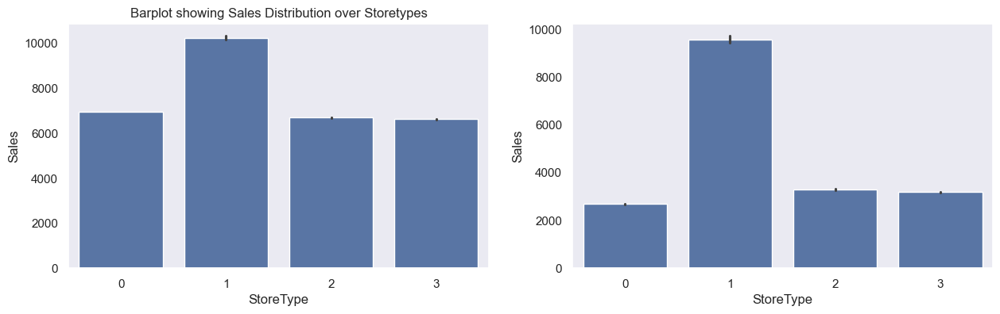

In [81]:
fig, (axis1,axis2) = plt.subplots(1,2,figsize=(15,4))

sns.barplot(x='StoreType', y='Sales', data=weekdays_data,ax=axis1).set(title='Barplot showing Sales Distribution over Storetypes')
sns.barplot(x='StoreType', y='Sales', data=weekend_data, ax=axis2)

Check how the assortment type affects sales

<Axes: xlabel='Assortment', ylabel='Customers'>

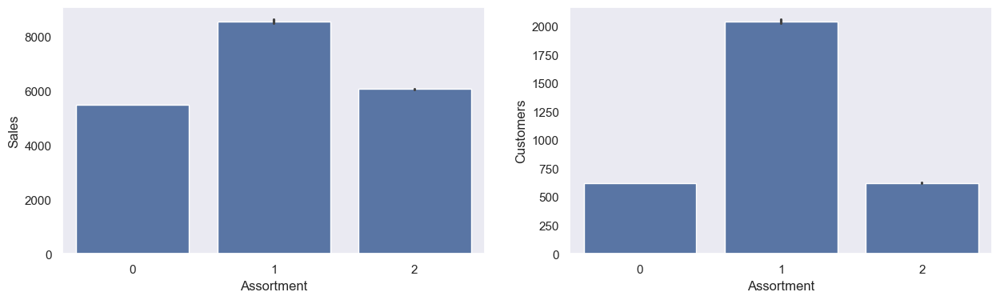

In [82]:
fig, (axis1,axis2) = plt.subplots(1,2,figsize=(15,4))

sns.barplot(x='Assortment', y='Sales', data=train_store_data, ax=axis1)
sns.barplot(x='Assortment', y='Customers', data=train_store_data,  ax=axis2)

Sales are highest for Assortment 1, followed by Assortment 2, then Assortment 0.
Customer numbers show a similar pattern, with Assortment 1 attracting the most customers, followed by 0 and 2.
There's a strong correlation between sales and customer numbers across assortments.
Assortment 1 significantly outperforms the others in both sales and customer attraction, suggesting it may offer the most popular or diverse product range.

How does the distance to the next competitor affect sales? What if the store and
its competitors all happen to be in city centres, does the distance matter in that
case?

In [83]:
x=train_store_data['CompetitionDistance']
y=train_store_data['Sales']
fig = px.scatter(x=x, y=y)
fig.update_layout(title='SCatterPlot for Competitor Distance and sales',xaxis_title='Cometitor Distance in metres',
                   yaxis_title='Sales') 
fig.show()

The scatter plot shows a negative correlation between competitor distance and sales, with highest sales occurring when competitors are nearby (0-5,000 meters).
Sales generally range from 0 to 40,000 units, with most falling below 25,000.
Data points are heavily concentrated between 0-30,000 meters competitor distance, becoming sparser beyond 40,000 meters.
There's high variability in sales at shorter distances, which decreases as distance increases.

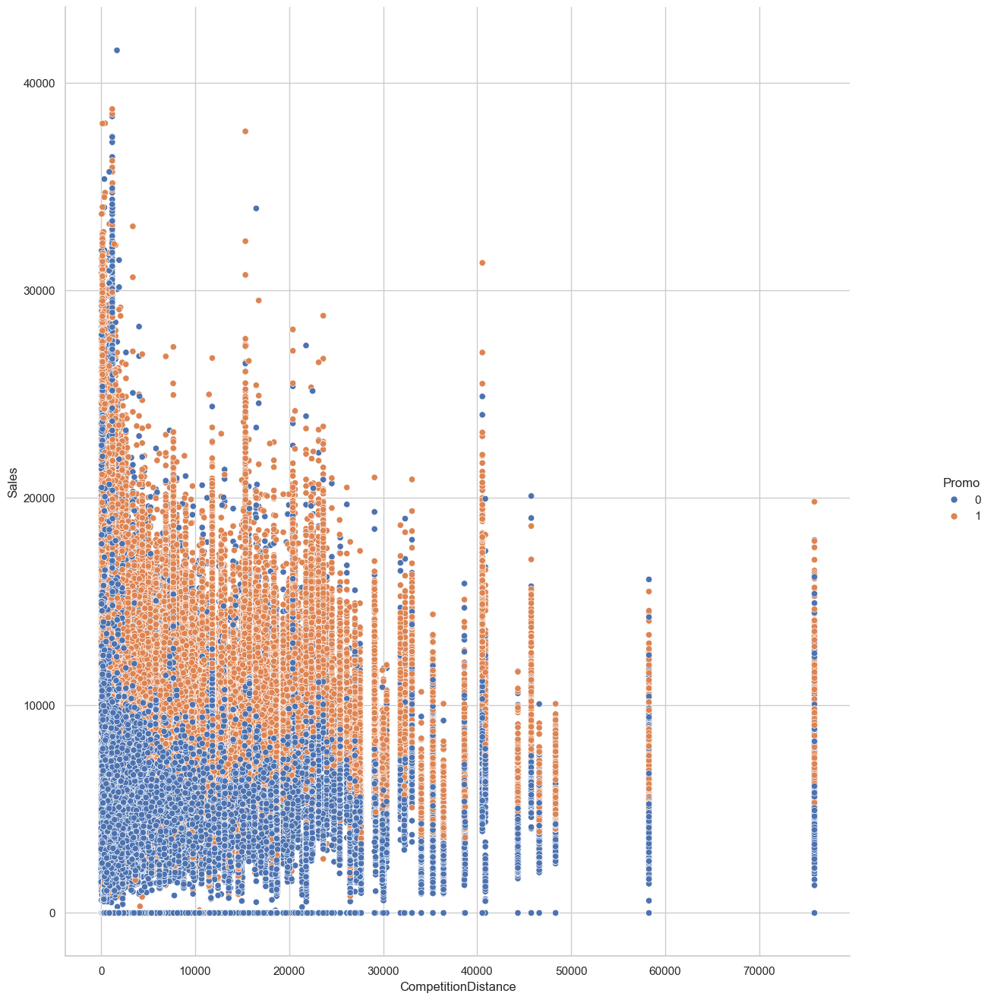

In [84]:
sns.set(style="whitegrid")
g=sns.relplot(x="CompetitionDistance", y="Sales", hue="Promo", data=train_store_data)
g.fig.set_size_inches(15,15)


Data distribution:Most data points are clustered at lower CompetitionDistance values (0-20,000)
Sales values are more evenly distributed but concentrated between 0-20,000

Promo effect:Orange points (Promo = 1) generally appear higher on the Sales axis than blue points (Promo = 0)
This suggests promotions tend to increase sales across various competition distances

Competition distance impact: There's a slight negative trend: as CompetitionDistance increases, the maximum Sales values tend to decrease
However, this trend is weak and there's significant variability

Data density: Highest density of points is in the lower left quadrant (low CompetitionDistance, low-to-medium Sales)
Data becomes sparser as CompetitionDistance increases

Promotion distribution: Promo = 1 (orange) points appear slightly more frequent, especially at higher sales values
In conclusion, while there's a slight negative relationship between competition distance and sales, the effect seems weak. Promotions appear to boost sales across all competition distances. The high variability suggests other factors not shown in this plot likely play important roles in determining sales performance. C

In [85]:
import plotly.graph_objects as go 
fig = go.Figure(data=go.Scattergl(
    x=train_store_data['CompetitionDistance'],
    y=train_store_data['Sales'],
    mode='markers',
    marker=dict(
        
        colorscale='Viridis',
        line_width=1
    )
  
))
fig.update_layout(title='SCatterPlot for Competitor Distance and sales',xaxis_title='Cometitor Distance in metres',
                   yaxis_title='Sales') 
fig.show()

Concentration: Most data points are clustered between 0-30,000 meters competitor distance.
Sales range: Sales generally range from 0 to about 40,000 units, with most falling below 25,000.
Negative correlation: There appears to be a slight negative correlation between competitor distance and sales. As distance increases, sales tend to decrease.
Highest sales: The highest sales occur when competitors are very close (0-5,000 meters).
Variability: There's high variability in sales at shorter distances, which decreases as distance increases.
Outliers: Some outliers exist, particularly at longer distances with higher sales.
Data sparsity: Data becomes sparser as competitor distance increases beyond 40,000 meters.

In [86]:
train_store_data.head()

,Store,DayOfWeek,Sales,Customers,Open,Promo,SchoolHoliday,Date,StateHoliday,StoreType,...,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,PromoInterval,Year,Month,Day,SalePerCustomer
0,1,5,5263,555,1,1,1,2015-07-31,o,2,...,9.0,2008.0,0,0.0,0.0,0,2015,7,31,9.482883
1,2,5,6064,625,1,1,1,2015-07-31,o,0,...,11.0,2007.0,1,13.0,2010.0,"Jan,Apr,Jul,Oct",2015,7,31,9.702400
2,3,5,8314,821,1,1,1,2015-07-31,o,0,...,12.0,2006.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct",2015,7,31,10.126675
3,4,5,13995,1498,1,1,1,2015-07-31,o,2,...,9.0,2009.0,0,0.0,0.0,0,2015,7,31,9.342457
4,5,5,4822,559,1,1,1,2015-07-31,o,0,...,4.0,2015.0,0,0.0,0.0,0,2015,7,31,8.626118


In [87]:
top_5_stores=train_store_data.sort_values(by='Sales',ascending=False).head(5)
top_5_stores

,Store,DayOfWeek,Sales,Customers,Open,Promo,SchoolHoliday,Date,StateHoliday,StoreType,...,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,PromoInterval,Year,Month,Day,SalePerCustomer
44393,909,1,41551,1721,1,0,0,2015-06-22,o,0,...,0.0,0.0,1,45.0,2009.0,"Feb,May,Aug,Nov",2015,6,22,24.143521
132945,262,5,38722,5132,1,1,0,2015-04-03,b,1,...,5.0,2013.0,0,0.0,0.0,0,2015,4,3,7.545207
101725,262,5,38484,5458,1,1,0,2015-05-01,a,1,...,5.0,2013.0,0,0.0,0.0,0,2015,5,1,7.050934
87230,262,4,38367,5192,1,0,1,2015-05-14,a,1,...,5.0,2013.0,0,0.0,0.0,0,2015,5,14,7.389638
424065,57,1,38037,1970,1,1,0,2014-06-16,o,3,...,6.0,2014.0,0,0.0,0.0,0,2014,6,16,19.308122


This dataset captures store sales performance across various types, including factors like promotions, holidays, and competition. It spans 2014-2015, showing significant variations in sales (3,900-10,172) and customer numbers (390-2,526). The data allows for analysis of how different elements impact sales, with metrics like sales per customer (4.1-19.3) providing insights into store efficiency and effectiveness.

In [18]:
# Saving the cleaned training DataFrame to a CSV file
train_store_data.to_csv('cleaned_train_store_data.csv')